In [1]:
%matplotlib inline

import numpy as np
import pydicom
import os
import matplotlib.pyplot as plt
from glob import glob
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import scipy.ndimage
from skimage import morphology
from skimage import measure
from skimage.transform import resize
from sklearn.cluster import KMeans
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.tools import FigureFactory as FF
from plotly.graph_objs import *
init_notebook_mode(connected=True) 

In [2]:
data_path = '/Users/ninadmohite/Downloads/1 2/1.1'
output_path = working_path = "/Users/ninadmohite/Downloads"
g = glob(data_path + '/*.dcma')

print ("Total of %d DICOM images.\nFirst 5 filenames:" % len(g))
print ('\n'.join(g[:5]))

Total of 78 DICOM images.
First 5 filenames:
/Users/ninadmohite/Downloads/1 2/1.1/ser601img00033.dcm.dcma
/Users/ninadmohite/Downloads/1 2/1.1/ser601img00032.dcm.dcma
/Users/ninadmohite/Downloads/1 2/1.1/ser601img00044.dcm.dcma
/Users/ninadmohite/Downloads/1 2/1.1/ser601img00045.dcm.dcma
/Users/ninadmohite/Downloads/1 2/1.1/ser601img00039.dcm.dcma


In [3]:
def load_scan(path):
    x = os.listdir(path)
    x.remove('.DS_Store')
    x.sort()
    print(x)
    
    slices = [pydicom.dcmread(path + '/' + s, force = True) for s in x]
    #slices.pop(0)
    print(slices[0])
    #slices.sort(key = lambda x: int(x.InstanceNumber))
   # print(slices)
    try:
        slice_thickness = np.abs(slices[0].ImagePositionPatient[2] - slices[1].ImagePositionPatient[2])
    except:
        slice_thickness = np.abs(slices[0].SliceLocation - slices[1].SliceLocation)
        
    for s in slices:
        s.SliceThickness = slice_thickness
        
    return slices

def get_pixels_hu(scans):
    image = np.stack([s.pixel_array for s in scans])
    # Convert to int16 (from sometimes int16), 
    # should be possible as values should always be low enough (<32k)
    image = image.astype(np.int16)

    # Set outside-of-scan pixels to 1
    # The intercept is usually -1024, so air is approximately 0
    image[image == -2000] = 0
    
    # Convert to Hounsfield units (HU)
    intercept = scans[0].RescaleIntercept
    slope = scans[0].RescaleSlope
    #intercept = scans[0].RescaleIntercept if 'RescaleIntercept' in scans[0] else -1024
    #slope = scans[0].RescaleSlope if 'RescaleSlope' in scans[0] else 1
    
    if slope != 1:
        image = slope * image.astype(np.float64)
        image = image.astype(np.int16)
        
    image += np.int16(intercept)
    
    return np.array(image, dtype=np.int16)

id=0
patient = load_scan(data_path)
imgs = get_pixels_hu(patient)

['ser601img00001.dcm.dcma', 'ser601img00002.dcm.dcma', 'ser601img00003.dcm.dcma', 'ser601img00004.dcm.dcma', 'ser601img00005.dcm.dcma', 'ser601img00006.dcm.dcma', 'ser601img00007.dcm.dcma', 'ser601img00008.dcm.dcma', 'ser601img00009.dcm.dcma', 'ser601img00010.dcm.dcma', 'ser601img00011.dcm.dcma', 'ser601img00012.dcm.dcma', 'ser601img00013.dcm.dcma', 'ser601img00014.dcm.dcma', 'ser601img00015.dcm.dcma', 'ser601img00016.dcm.dcma', 'ser601img00017.dcm.dcma', 'ser601img00018.dcm.dcma', 'ser601img00019.dcm.dcma', 'ser601img00020.dcm.dcma', 'ser601img00021.dcm.dcma', 'ser601img00022.dcm.dcma', 'ser601img00023.dcm.dcma', 'ser601img00024.dcm.dcma', 'ser601img00025.dcm.dcma', 'ser601img00026.dcm.dcma', 'ser601img00027.dcm.dcma', 'ser601img00028.dcm.dcma', 'ser601img00029.dcm.dcma', 'ser601img00030.dcm.dcma', 'ser601img00031.dcm.dcma', 'ser601img00032.dcm.dcma', 'ser601img00033.dcm.dcma', 'ser601img00034.dcm.dcma', 'ser601img00035.dcm.dcma', 'ser601img00036.dcm.dcma', 'ser601img00037.dcm.dcma', 

In [4]:
np.save(output_path + "fullimages_%d.npy" % (id), imgs)

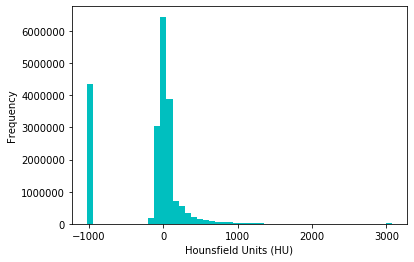

In [5]:
file_used=output_path+"fullimages_%d.npy" % id
imgs_to_process = np.load(file_used).astype(np.float64) 

plt.hist(imgs_to_process.flatten(), bins=50, color='c')
plt.xlabel("Hounsfield Units (HU)")
plt.ylabel("Frequency")
plt.show()

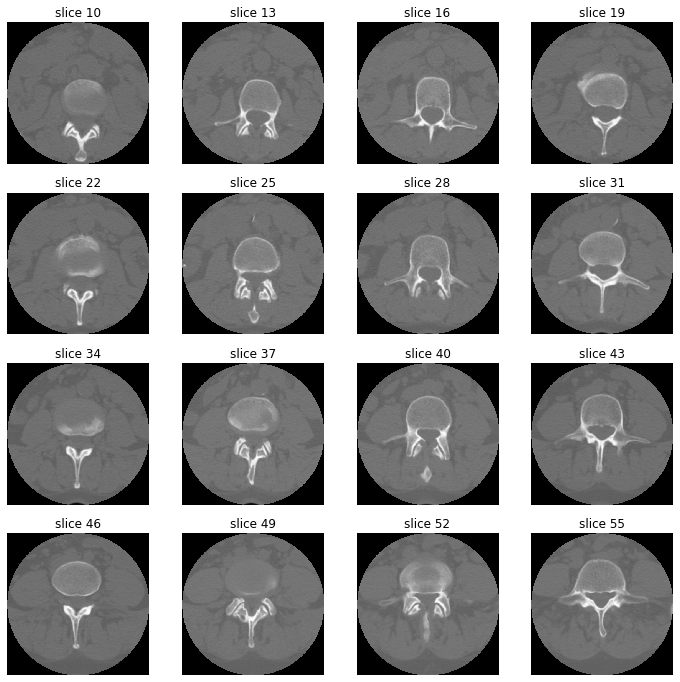

In [6]:
id = 0
imgs_to_process = np.load(output_path+'fullimages_{}.npy'.format(id))

def sample_stack(stack, rows=4, cols=4, start_with=10, show_every=3):
    fig,ax = plt.subplots(rows,cols,figsize=[12,12])
    for i in range(rows*cols):
        ind = start_with + i*show_every
        ax[int(i/rows),int(i % rows)].set_title('slice %d' % ind)
        ax[int(i/rows),int(i % rows)].imshow(stack[ind],cmap='gray')
        ax[int(i/rows),int(i % rows)].axis('off')
    plt.show()

sample_stack(imgs_to_process)

In [7]:
print ("Slice Thickness: %f" % float(patient[0].SliceThickness))
print ("Pixel Spacing (row, col): (%f, %f) " % (patient[0].PixelSpacing[0], patient[0].PixelSpacing[1]))

Slice Thickness: 0.312492
Pixel Spacing (row, col): (0.371094, 0.371094) 


In [8]:
id = 0
imgs_to_process = np.load(output_path+'fullimages_{}.npy'.format(id))
def resample(image, scan, new_spacing=[1,1,1]):
    # Determine current pixel spacing
    #spacing = map(float, (scan[0].SliceThickness + scan[0].PixelSpacing))
    spacing = np.array([scan[0].SliceThickness] + list(scan[0].PixelSpacing), dtype=np.float32)
    #print
    spacing = np.array(spacing)
    print(spacing)
    resize_factor = spacing / new_spacing
    new_real_shape = image.shape * resize_factor
    new_shape = np.round(new_real_shape)
    real_resize_factor = new_shape / image.shape
    new_spacing = spacing / real_resize_factor
    
    image = scipy.ndimage.interpolation.zoom(image, real_resize_factor)
    
    return image, new_spacing

print("Shape before resampling\t", imgs_to_process.shape)
imgs_after_resamp, spacing = resample(imgs_to_process, patient, [1,1,1])
print("Shape after resampling\t", imgs_after_resamp.shape)

Shape before resampling	 (78, 512, 512)
[0.312492 0.371094 0.371094]
Shape after resampling	 (24, 190, 190)


In [9]:
def make_mesh(image, threshold=-300, step_size=1):

    print("Transposing surface")
    p = image.transpose(2,1,0)
    
    print("Calculating surface")
    verts, faces, norm, val = measure.marching_cubes_lewiner(p, threshold, step_size=step_size, allow_degenerate=True) 
    return verts, faces

def plotly_3d(verts, faces):
    x,y,z = zip(*verts) 
    
    print("Drawing")
    
    # Make the colormap single color since the axes are positional not intensity. 
#    colormap=['rgb(255,105,180)','rgb(255,255,51)','rgb(0,191,255)']
    colormap=['rgb(236, 236, 212)','rgb(236, 236, 212)']
    
    fig = FF.create_trisurf(x=x,
                        y=y, 
                        z=z, 
                        plot_edges=False,
                        colormap=colormap,
                        simplices=faces,
                        backgroundcolor='rgb(64, 64, 64)',
                        title="Interactive Visualization")
    iplot(fig)

def plt_3d(verts, faces):
    print("Drawing")
    x,y,z = zip(*verts) 
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Fancy indexing: `verts[faces]` to generate a collection of triangles
    mesh = Poly3DCollection(verts[faces], linewidths=0.05, alpha=1)
    face_color = [1, 1, 0.9]
    mesh.set_facecolor(face_color)
    ax.add_collection3d(mesh)

    ax.set_xlim(0, max(x))
    ax.set_ylim(0, max(y))
    ax.set_zlim(0, max(z))
    ax.set_facecolor((0.7, 0.7, 0.7))
    plt.show()

Transposing surface
Calculating surface
Drawing


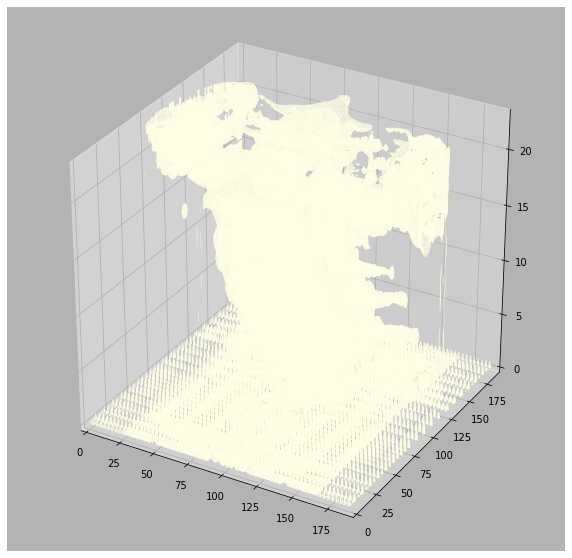

In [10]:
v, f = make_mesh(imgs_after_resamp, 200)
plt_3d(v, f)

In [18]:
v, f = make_mesh(imgs_after_resamp, 225, 1)
plotly_3d(v, f)

Transposing surface
Calculating surface
Drawing


In [19]:
def make_vertmask(img, display=False):
    row_size= img.shape[0]
    col_size = img.shape[1]
    print(row_size)
    print(col_size)
    
    mean = np.mean(img)
    print(mean)
    std = np.std(img)
    img = img-mean
    img = img/std
    # Find the average pixel value near the vertebra
    # to renormalize washed out images 
    middle = img[int(col_size/5):int(col_size/5*4),int(row_size/5):int(row_size/5*4)] 
    #print(middle)
    mean = np.mean(middle)  
    max = np.max(img)
    min = np.min(img)
    # To improve threshold finding, I'm moving the 
    # underflow and overflow on the pixel spectrum
    img[img==max]=mean
    img[img==min]=mean
    #
    # Using Kmeans to separate foreground (soft tissue / bone) and background (air)
    #
    kmeans = KMeans(n_clusters=2).fit(np.reshape(middle,[np.prod(middle.shape),1]))
    centers = sorted(kmeans.cluster_centers_.flatten())
    threshold = np.mean(centers)
    #print(threshold)
    thresh_img = np.where(img>threshold,1.0,0.0)  # threshold the image

    # First erode away the finer elements, then dilate to include some of the pixels surrounding the vertebra.  
    # We don't want to accidentally clip the vertebra.

    eroded = morphology.erosion(thresh_img,np.ones([3,3]))
    dilation = morphology.dilation(eroded,np.ones([8,8]))

    labels = measure.label(dilation) # Different labels are displayed in different colors
    label_vals = np.unique(labels)
    regions = measure.regionprops(labels)
    good_labels = []
    for prop in regions:
        B = prop.bbox
        if B[2]-B[0]<row_size/10*9 and B[3]-B[1]<col_size/10*9 and B[0]>row_size/5 and B[2]<col_size/5*4:
            good_labels.append(prop.label)
    mask = np.ndarray([row_size,col_size],dtype=np.int8)
    mask[:] = 0

    #
    #  After just the vertebra are left, we do another large dilation
    #  in order to fill in and out the vertebra mask 
    #
    for N in good_labels:
        mask = mask + np.where(labels==N,1,0)
    mask = morphology.dilation(mask,np.ones([10,10])) # one last dilation

    if (display):
        fig, ax = plt.subplots(3, 2, figsize=[12, 12])
        ax[0, 0].set_title("Original")
        ax[0, 0].imshow(img, cmap='gray')
        ax[0, 0].axis('off')
        ax[0, 1].set_title("Threshold")
        ax[0, 1].imshow(thresh_img, cmap='gray')
        ax[0, 1].axis('off')
        ax[1, 0].set_title("After Erosion and Dilation")
        ax[1, 0].imshow(dilation, cmap='gray')
        ax[1, 0].axis('off')
        ax[1, 1].set_title("Color Labels")
        ax[1, 1].imshow(labels)
        ax[1, 1].axis('off')
        ax[2, 0].set_title("Final Mask")
        ax[2, 0].imshow(mask, cmap='gray')
        ax[2, 0].axis('off')
        ax[2, 1].set_title("Apply Mask on Original")
        ax[2, 1].imshow(mask*img, cmap='gray')
        ax[2, 1].axis('off')
        
        plt.show()
    return mask*img

In [82]:
imgs_after_resamp.min()

-1586

In [83]:
imgs_after_resamp.max()

3528

In [111]:
'''def get_pixels_hu(slices):
    image = np.stack([s.pixel_array for s in slices])
    # Convert to int16 (from sometimes int16), 
    # should be possible as values should always be low enough (<32k)
    image = image.astype(np.int16)

    # Set outside-of-scan pixels to 0
    # The intercept is usually -1024, so air is approximately 0
    image[image == -2000] = 0
    
    # Convert to Hounsfield units (HU)
    for slice_number in range(len(slices)):
        
        #intercept = slices[slice_number].RescaleIntercept
        #slope = slices[slice_number].RescaleSlope
        intercept = slices[0].RescaleIntercept if 'RescaleIntercept' in slices[0] else -1024
        slope = slices[0].RescaleSlope if 'RescaleSlope' in slices[0] else 1
        if slope != 1:
            image[slice_number] = slope * image[slice_number].astype(np.float64)
            image[slice_number] = image[slice_number].astype(np.int16)
            
        image[slice_number] += np.int16(intercept)
    
    return np.array(image, dtype=np.int16)

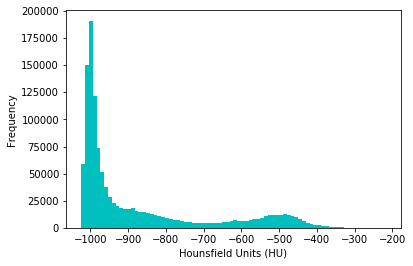

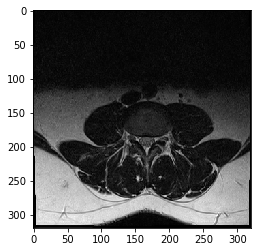

In [115]:
first_patient = load_scan(INPUT_FOLDER)
first_patient_pixels = get_pixels_hu(first_patient)
plt.hist(first_patient_pixels.flatten(), bins=80, color='c')
plt.xlabel("Hounsfield Units (HU)")
plt.ylabel("Frequency")
plt.show()

# Show some slice in the middle
plt.imshow(first_patient_pixels[10], cmap=plt.cm.gray)
plt.show()

In [116]:
def resample(image, scan, new_spacing=[1,1,1]):
    # Determine current pixel spacing
    spacing = np.array([scan[0].SliceThickness] + list(scan[0].PixelSpacing), dtype=np.float32)
    #spacing = np.array([scan[0].SliceThickness], list(scan[0].PixelSpacing[0]), dtype=np.float32)
    resize_factor = spacing / new_spacing
    new_real_shape = image.shape * resize_factor
    new_shape = np.round(new_real_shape)
    real_resize_factor = new_shape / image.shape
    new_spacing = spacing / real_resize_factor
    
    image = scipy.ndimage.interpolation.zoom(image, real_resize_factor, mode='nearest')
    
    return image, new_spacing

In [117]:
pix_resampled, spacing = resample(first_patient_pixels, first_patient, [1,1,1])
print("Shape before resampling\t", first_patient_pixels.shape)
print("Shape after resampling\t", pix_resampled.shape)
print(spacing.dtype)

Shape before resampling	 (12, 320, 320)
Shape after resampling	 (46, 220, 220)
float64


In [130]:
def plot_3d(image, threshold=-300, step_size=1):
    
    # Position the scan upright, 
    
    # so the head of the patient would be at the top facing the camera
    p = image.transpose(2,1,0)
    
    verts, faces = measure.marching_cubes_lewiner(p, threshold)

    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Fancy indexing: `verts[faces]` to generate a collection of triangles
    mesh = Poly3DCollection(verts[faces], alpha=0.70)
    face_color = [0.45, 0.45, 0.75]
    mesh.set_facecolor(face_color)
    ax.add_collection3d(mesh)

    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])

    plt.show()

In [131]:
plot_3d(pix_resampled, -400)

ValueError: too many values to unpack (expected 2)

In [128]:
pix_resampled.min()

-1118

In [2]:
'''def load_scan(path):
    slices = [pydicom.dcmread(path + '/' + s, force=True) for s in               
              os.listdir(path)]
    slices = [s for s in slices if 'SliceLocation' in s]
    slices.sort(key = lambda x: int(x.InstanceNumber))
    try:
        slice_thickness = np.abs(slices[0].ImagePositionPatient[2] -   
                          slices[1].ImagePositionPatient[2])
    except:
        slice_thickness = np.abs(slices[0].SliceLocation - 
                      slices[1].SliceLocation)
    for s in slices:
        s.SliceThickness = slice_thickness
    return slices
def get_pixels_hu(scans):
 
    image = np.stack([s.pixel_array for s in scans])
    image = image.astype(np.int16)
    # Set outside-of-scan pixels to 0
    # The intercept is usually -1024, so air is approximately 0
    image[image == -2000] = 0
    
    # Convert to Hounsfield units (HU)
    #intercept = scans[0].RescaleIntercept
    #slope = scans[0].RescaleSlope
    intercept = scans[0].RescaleIntercept if 'RescaleIntercept' in scans[0] else -1024
    slope = scans[0].RescaleSlope if 'RescaleSlope' in scans[0] else 1
    
    if slope != 1:
        image = slope * image.astype(np.float64)
        image = image.astype(np.int16)
        
    image += np.int16(intercept)
    
    return np.array(image, dtype=np.int16)'''


Dataset created in /Users/ninadmohite/nilearn_data/neurovault



['/Users/ninadmohite/nilearn_data/neurovault/collection_658/image_10426.nii.gz']

In [3]:
motor_images = 

{'images': ['/Users/ninadmohite/nilearn_data/neurovault/collection_658/image_10426.nii.gz'],
 'images_meta': [{'url': 'https://neurovault.org/images/10426/',
   'id': 10426,
   'file': 'https://neurovault.org/media/images/658/task001_left_vs_right_motor.nii.gz',
   'collection': 'https://neurovault.org/collections/658/',
   'collection_id': 658,
   'file_size': 186649,
   'cognitive_paradigm_cogatlas': None,
   'cognitive_paradigm_cogatlas_id': None,
   'cognitive_contrast_cogatlas': None,
   'cognitive_contrast_cogatlas_id': None,
   'map_type': 'other',
   'analysis_level': None,
   'name': 'task001 left vs right motor',
   'description': None,
   'add_date': '2016-01-21T17:22:58.807468Z',
   'modify_date': '2016-01-27T21:59:40.180124Z',
   'is_valid': False,
   'surface_left_file': None,
   'surface_right_file': None,
   'data_origin': 'volume',
   'target_template_image': 'GenericMNI',
   'subject_species': 'homo sapiens',
   'figure': None,
   'handedness': None,
   'age': None,
 

In [1]:
%matplotlib inline

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import dicom
import os
import scipy.ndimage
import matplotlib.pyplot as plt

from skimage import measure, morphology
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

# Some constants 


/Users/ninadmohite/opt/anaconda3/lib/python3.7/site-packages/dicom/__init__.py:53: UserWarning: 
This code is using an older version of pydicom, which is no longer 
maintained as of Jan 2017.  You can access the new pydicom features and API 
by installing `pydicom` from PyPI.
See 'Transitioning to pydicom 1.x' section at pydicom.readthedocs.org 
for more information.

  warnings.warn(msg)


In [28]:
data_dir = '/Volumes/Samsung_T5/Thesis MRI Data/'
patients = os.listdir(data_dir)
patients

['.DS_Store', '1.1']

In [29]:
patients.pop(0)

'.DS_Store'

In [30]:
patients

['1.1']

In [34]:
for patient in patients:
    path = data_dir + patient
    slices = load_scan(path)
    slices.sort(key = lambda x: int(x.ImagePositionPatient[2]))
    print(len(slices))
    print(slices[0])

RuntimeError: generator raised StopIteration

In [16]:
data_path = '/Volumes/Samsung_T5/Thesis MRI Data/1.1'
name = os.listdir(data_path)
name.pop(0)
print(name[0][:14])

for file in name:
      src=file
      dst= src[:14]+".dicom"
      os.rename(src,dst)

    
#output_path = working_path = "/Volumes/Samsung_T5/"
#g = glob(data_path + '/*.dcma')

#print ("Total of %d DICOM images.\nFirst 5 filenames:" % len(g))
#print ('\n'.join(g[:5]))

ser601img00003


FileNotFoundError: [Errno 2] No such file or directory: 'ser601img00003.dcm.dcma' -> 'ser601img00003.dicom'